In [1]:
import sys
sys.path.append(r'D:\Python ML\SA-geochemical-maps\src')
import cartopy.crs as ccrs
from matplotlib.colors import BoundaryNorm, LogNorm
import matplotlib.pyplot as plt
import matplotlib as mpl


import create_chem_dataset as ccd
import max_dh_chem as mdc
from interpolation import MapBase, interpolate

import pandas as pd
import numpy as np

In [2]:
source_path = r'D:\Unearthed_SARIG_Data_Package\SARIG_Data_Package\sarig_rs_chem_exp.csv'
out_path = r'D:\Python ML\SA-geochemical-maps\Data\Processed_2'
drill_hole_spatial = r'D:\Python ML\SA-geochemical-maps\Data\interim\DH_data.csv'
method_path = r'D:\Python ML\SA-geochemical-maps\notebooks\chem_method_code_map.csv'


In [3]:
elements = ['Fe2O3','U','Ag','Pb','Cu','Zn','Co','Li','Ni','Fe','NiO', 'U3O8', 'Au', 'FeO', 'CoO']

element = 'Ni'

In [4]:
clean_Ni = ccd.create_dh_chem_data(source_path, element, method_path, out_path)
clean_NiO = ccd.create_dh_chem_data(source_path, element='NiO', method_path=method_path, out_path=out_path)

Need to remove spurious samples and holes as determined during the EDA phase, before determining max DH value

In [5]:
clean_Ni.drop(clean_Ni[clean_Ni.DETERMINATION.str.contains(r'unknown', na=False, regex=False)].index, inplace=True)
clean_Ni.drop(clean_Ni[clean_Ni.DETERMINATION.str.contains(r'UKN', na=False, regex=False)].index, inplace=True)
clean_Ni.drop(clean_Ni[clean_Ni.DETERMINATION.str.contains(r'pXRF', na=False, regex=False)].index, inplace=True)

clean_NiO.drop(clean_NiO[clean_NiO.DETERMINATION.str.contains(r'unknown', na=False, regex=False)].index, inplace=True)
clean_NiO.drop(clean_NiO[clean_NiO.DETERMINATION.str.contains(r'UKN', na=False, regex=False)].index, inplace=True)
clean_NiO.drop(clean_NiO[clean_NiO.DETERMINATION.str.contains(r'pXRF', na=False, regex=False)].index, inplace=True)



In [6]:
# drop all samples (24) done by Centrex by ME-XRF11 method, all with significantly high Ni values (in the 9-50% range)
clean_Ni.drop(clean_Ni[clean_Ni.CHEM_METHOD_CODE.str.contains(r'ME-XRF11', na=False, regex=False)].index, inplace=True)

Join Ni and NiO tables together

In [7]:
clean_Ni = clean_Ni.append(clean_NiO)

In [8]:
norm_data = mdc.max_dh_chem(clean_Ni, drill_hole_spatial)

Normalise max dh data to average crustal abundance

In [9]:
norm_data['times_ave_crustal_abund'] = norm_data.converted_ppm.apply(lambda x: x / 59)

In [10]:
norm_data.head()

,SAMPLE_NO,SAMPLE_SOURCE_CODE,DRILLHOLE_NUMBER,DH_DEPTH_FROM,DH_DEPTH_TO,SAMPLE_ANALYSIS_NO,ANALYSIS_TYPE_DESC,LABORATORY,CHEM_CODE,VALUE,...,BDL,converted_ppm,DETERMINATION,DIGESTION,FUSION,DH_NAME,SITE_NO,LONGITUDE_GDA2020,LATITUDE_GDA2020,times_ave_crustal_abund
0,2962207,HCORE,332863.0,28.0,29.0,2469718,GEOCHEMISTRY,"ALS Chemex, Adelaide SA",Ni,26.0,...,0,26.000,ICP-AES,4A,unknown,HDD-417,2125455,137.872503,-34.536531,0.440678
1,943276,CT,208084.0,82.0,83.0,560978,GEOCHEMISTRY,"AMDEL Laboratory, S.A.",Ni,71.0,...,0,71.000,ICP-OES,AR,unknown,VGO 28,1071571,140.561432,-32.106462,1.203390
2,458875,CT,148.0,338.0,340.0,150904,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",Ni,4.0,...,1,0.001,AAS,N/S,unknown,BN 1,182,129.166978,-31.168831,0.000017
3,1582688,CT,232500.0,12.0,16.0,1183366,GEOCHEMISTRY,Analabs Pty Ltd.,Ni,5.0,...,0,5.000,ICP-OES,3A,unknown,MT019,1204739,134.436222,-30.735152,0.084746
4,458886,CT,149.0,300.0,302.0,150906,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",Ni,4.0,...,1,0.001,AAS,N/S,unknown,BN 2,183,129.163525,-31.162481,0.000017


In [11]:
norm_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 109507 entries, 0 to 109506
Data columns (total 22 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   SAMPLE_NO                109507 non-null  int64  
 1   SAMPLE_SOURCE_CODE       109493 non-null  object 
 2   DRILLHOLE_NUMBER         109507 non-null  float64
 3   DH_DEPTH_FROM            109380 non-null  float64
 4   DH_DEPTH_TO              109202 non-null  float64
 5   SAMPLE_ANALYSIS_NO       109507 non-null  int64  
 6   ANALYSIS_TYPE_DESC       109507 non-null  object 
 7   LABORATORY               105190 non-null  object 
 8   CHEM_CODE                109507 non-null  object 
 9   VALUE                    109507 non-null  float64
 10  UNIT                     109507 non-null  object 
 11  CHEM_METHOD_CODE         109507 non-null  object 
 12  BDL                      109507 non-null  int64  
 13  converted_ppm            109507 non-null  float64
 14  DETE

In [12]:
norm_data.loc[norm_data['converted_ppm'].idxmax()]

SAMPLE_NO                                 1951167
SAMPLE_SOURCE_CODE                             DC
DRILLHOLE_NUMBER                         269229.0
DH_DEPTH_FROM                               253.0
DH_DEPTH_TO                                 253.5
SAMPLE_ANALYSIS_NO                        1523794
ANALYSIS_TYPE_DESC                   GEOCHEMISTRY
LABORATORY                 AMDEL Laboratory, S.A.
CHEM_CODE                                      Ni
VALUE                                    165000.0
UNIT                                          ppm
CHEM_METHOD_CODE                             IC3E
BDL                                             0
converted_ppm                            165000.0
DETERMINATION                             ICP-OES
DIGESTION                                      MA
FUSION                                    unknown
DH_NAME                                  D01PKN02
SITE_NO                                   1812819
LONGITUDE_GDA2020                       135.39089


In [13]:
norm_data.times_ave_crustal_abund.min()

1.694915254237288e-05

In [14]:
max_v, min_v = norm_data.times_ave_crustal_abund.max().astype(int), norm_data.times_ave_crustal_abund.min().astype(int) 
print(f'For the element {element}: the max value range is {max_v}, while the min is {min_v}')

proj = ccrs.epsg(3107)   #GDA 94/SA Lambert
levels = list(range(min_v, max_v, 1))
cmap = plt.get_cmap('plasma')
#norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)
log_norm = LogNorm()
n_dh = len(norm_data.DRILLHOLE_NUMBER)

For the element Ni: the max value range is 2796, while the min is 0


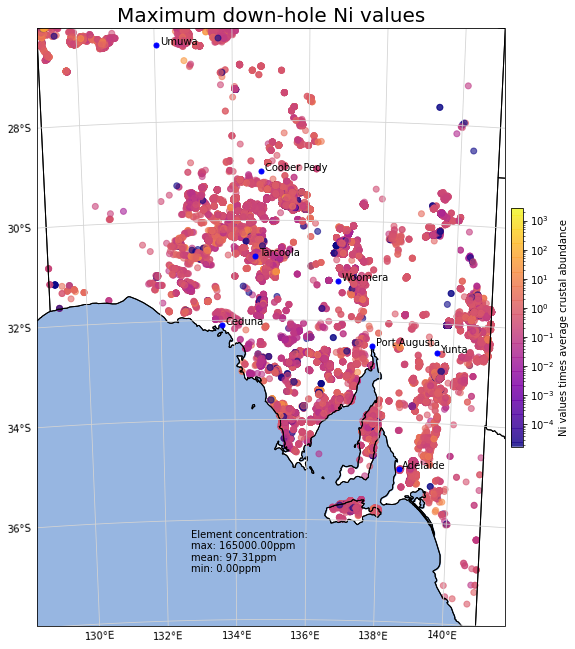

In [15]:
mpl.rcParams['agg.path.chunksize'] = 10000

title = f'Maximum down-hole {element} values'
label = f'{element} values times average crustal abundance'
out_fig = out_path+'\\'+f'Max_downhole_{element}.jpg'
inset_title = f'Number of drill holes:\n{n_dh}'
x, y = norm_data.LONGITUDE_GDA2020.values, norm_data.LATITUDE_GDA2020.values
max_val, min_val, mean_val = norm_data.converted_ppm.max(), norm_data.converted_ppm.min(), norm_data.converted_ppm.mean()
annot = f'Element concentration:\nmax: {max_val:.2f}ppm\nmean: {mean_val:.2f}ppm\nmin: {min_val:.2f}ppm'

fig, view, inset = MapBase(proj, title, inset_title, add_inset=False)
plot = view.scatter(x, y, c=norm_data.times_ave_crustal_abund, cmap=cmap, norm=log_norm, alpha=0.6, transform=ccrs.PlateCarree())
fig.colorbar(plot, ax=view, shrink=.4, pad=0.01, label=label) #boundaries=levels, 
#inset.plot(x, y,color='blue', marker='o', markersize=2, linestyle='None', transform=ccrs.Geodetic())
    
view.annotate(text=annot, xy=(0.33,0.09), xycoords='axes fraction')
plt.savefig(out_fig, dpi=300, bbox_inches='tight')
plt.show()

In [16]:
gx, gy, img = interpolate(norm_data, proj)

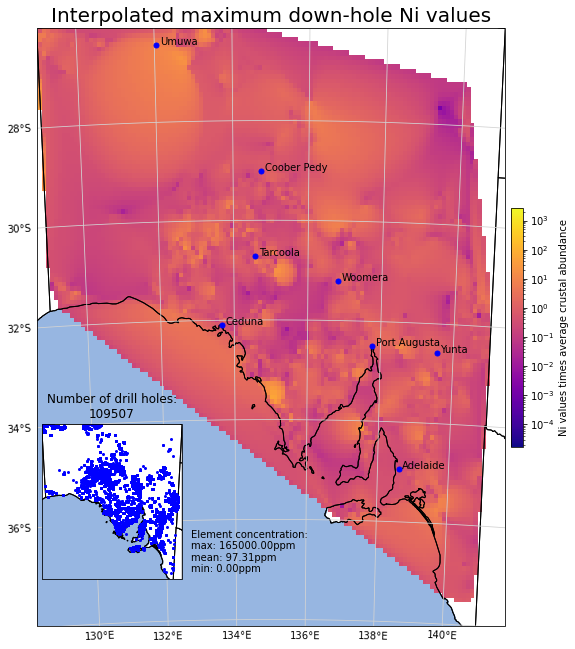

In [17]:
title = f'Interpolated maximum down-hole {element} values'
label = f'{element} values times average crustal abundance'
out_fig = out_path+'\\'+f'Interp_Max_downhole_{element}.jpg'
inset_title = f'Number of drill holes:\n{n_dh}'
x, y = norm_data.LONGITUDE_GDA2020.values, norm_data.LATITUDE_GDA2020.values
max_val, min_val, mean_val = norm_data.converted_ppm.max(), norm_data.converted_ppm.min(), norm_data.converted_ppm.mean()
annot = f'Element concentration:\nmax: {max_val:.2f}ppm\nmean: {mean_val:.2f}ppm\nmin: {min_val:.2f}ppm'

fig, view, inset = MapBase(proj, title, inset_title)
mmb = view.pcolormesh(gx, gy, img, cmap=cmap, norm=log_norm)
fig.colorbar(mmb, ax=view, shrink=.4, pad=0.01, label=label) #boundaries=levels, 
inset.plot(x, y,color='blue', marker='o', markersize=2, linestyle='None', transform=ccrs.Geodetic())
    
view.annotate(text=annot, xy=(0.33,0.09), xycoords='axes fraction')
plt.savefig(out_fig, dpi=300, bbox_inches='tight')
plt.show()